# **PRIMER EXAMEN PARCIAL**
# *Mera Montiel Gonzalo Sebastián*

## **1.- Investigar sobre el software libre LAPACK y BLAS, sobre su relación con Julia (revisar documentación y el libro de Burden).**

El alcance de un curso típico de análisis numérico, tal como se describe en el índice de Burden y Faires, abarca temas como la resolución de sistemas de ecuaciones lineales (Capítulo 6), técnicas iterativas en álgebra de matrices (Capítulo 7) y la aproximación de valores propios (Capítulo 9). Estos son precisamente los problemas para los que LAPACK fue diseñado. El texto de Burden y Faires reconoce explícitamente la existencia e importancia de software numérico de alta calidad. De hecho, se establece una conexión directa al afirmar que paquetes como BLAS y LAPACK, disponibles a través de Netlib, son "altamente eficientes, precisos y confiables". Esto establece el vínculo crucial: el libro de texto enseña el qué y el porqué de los algoritmos, mientras que las bibliotecas de software proporcionan el cómo definitivo.

* **LAPACK y BLAS — Resumen del Burden:**

El software para operaciones de matriz y la solución directa de sistemas lineales implementados en **IMSL** y **NAG** está basado en **LAPACK**, un paquete de subrutinas de dominio público. Existe excelente documentación y libros disponibles acerca de ellos. Nosotros nos enfocaremos en varias subrutinas disponibles en las tres fuentes.

LAPACK de acompañamiento es un conjunto de operaciones de nivel inferior llamadas **Subprogramas Básicos de Álgebra Lineal (BLAS)**. En general, el nivel 1 de BLAS consiste en operaciones vector-vector, como sumas de vector con datos de entrada y conteo de operaciones de $O(n)$. El nivel 2 consiste en operaciones matriz-vector, como el producto de una matriz y un vector con datos de entrada y conteo de operaciones de $O(n^2)$. El nivel 3 consiste en operaciones matriz-matriz, como productos de matriz con datos de entrada y conteo de operaciones de $O(n^3)$

Las subrutinas en **LAPACK** para resolver sistemas lineales primero factorizan la matriz \(A\). La factorización depende del tipo de matriz de la siguiente forma:

1. **Matriz general**  
   $PA = LU$

2. **Matriz definida positiva**  
   $A = LL^{t}$

3. **Matriz simétrica**  
   $A = LDL^{t}$

4. **Matriz tridiagonal**  
$A = LU$ (en forma de banda)

Además, se pueden calcular inversas y determinantes.

La Biblioteca **IMSL** incluye contrapartes para casi todas las subrutinas LAPACK y también bien algunas extensiones. La Biblioteca **NAG** tiene numerosas subrutinas para métodos directos para resolver sistemas lineales similares a los de LAPACK e IMSL.

  
* **LAPACK, extraído de la documentación oficial en https://www.netlib.org/lapack**

**LAPACK** está escrito en **Fortran 90** y provee rutinas para resolver sistemas simultáneos de ecuaciones lineales, soluciones por mínimos cuadrados de sistemas lineales, problemas de valores propios y problemas de valores singulares. También se proporcionan las factorizaciones de matriz asociadas (LU, Cholesky, QR, SVD, Schur, Schur generalizada), así como cálculos relacionados tales como la reordenación de las factorizaciones de Schur y la estimación de números de condición. Se manejan matrices densas y en banda, pero **no** matrices dispersas (sparse) generales. En todas las áreas, se ofrece funcionalidad similar para matrices reales y complejas, tanto en precisión simple como doble.

El objetivo original del proyecto LAPACK fue conseguir que las bibliotecas ampliamente usadas **EISPACK** y **LINPACK** se ejecutaran de forma eficiente en procesadores vectoriales y paralelos con memoria compartida. En estas máquinas, LINPACK y EISPACK son ineficientes porque sus patrones de acceso a memoria desatienden las jerarquías de memoria multinivel de las máquinas, pasando así demasiado tiempo moviendo datos en lugar de realizar operaciones de punto flotante útiles. LAPACK aborda este problema reorganizando los algoritmos para usar operaciones en bloques de matrices, como la multiplicación de matrices, en los bucles más internos. Estas operaciones en bloque pueden optimizarse para cada arquitectura para tener en cuenta la jerarquía de memoria, y de ese modo ofrecen una forma **transportable** de alcanzar alta eficiencia en diversas máquinas modernas. Usamos el término **"transportable"** en lugar de **"portátil"** porque, para obtener el mayor rendimiento posible, LAPACK requiere que las operaciones en bloque altamente optimizadas ya estén implementadas en cada máquina.

Las rutinas de LAPACK están escritas de modo que, en la medida de lo posible, el cómputo se realice mediante llamadas a los **Basic Linear Algebra Subprograms (BLAS)**. LAPACK está diseñado desde el inicio para explotar el **BLAS de Nivel 3** — un conjunto de especificaciones para subprogramas Fortran que realizan varios tipos de multiplicación de matrices y la solución de sistemas triangulares con múltiples lados derechos. Debido a la granularidad gruesa de las operaciones del BLAS de Nivel 3, su uso favorece la alta eficiencia en muchos ordenadores de alto rendimiento, particularmente si el fabricante provee implementaciones especialmente codificadas.

Implementaciones máquina-específicas y altamente eficientes del **BLAS** están disponibles para muchas computadoras modernas de alto rendimiento. Para detalles sobre BLAS provistos por un vendedor o ISV, consulte las preguntas frecuentes (BLAS FAQ). Alternativamente, el usuario puede descargar **ATLAS** para generar automáticamente una biblioteca BLAS optimizada para su arquitectura. Existe una implementación de referencia en Fortran 77 del BLAS disponible desde **netlib**; sin embargo, su uso no es recomendable ya que no rendirá tan bien como una implementación específicamente ajustada.

**Licencia:**  
LAPACK es un paquete de software de libre disponibilidad. Está disponible desde **netlib** vía FTP anónimo y la World Wide Web en http://www.netlib.org/lapack. Por lo tanto, puede incluirse en paquetes de software comerciales (y de hecho ha sido incluido). Solo pedimos que se otorgue el crédito apropiado a los autores.

La licencia usada para el software es la **licencia BSD modificada**, ver:

LICENSE

Como todo software, está protegido por derechos de autor. No está registrada como marca, pero pedimos lo siguiente:
Si modifica el código fuente de estas rutinas pedimos que cambie el nombre de la rutina y comente los cambios realizados respecto al original.
Con gusto responderemos cualquier pregunta respecto al software. Si se realiza una modificación, sin embargo, es responsabilidad de la persona que modificó la rutina proporcionar soporte.

LAPACK, versión 3.12.1  
Descarga: `lapack-3.12.1.tar.gz`

Repositorio GIT de LAPACK
El repositorio GIT de LAPACK (`http://github.com/Reference-LAPACK/lapack`) está abierto en **modo solo lectura** para nuestros usuarios.

* **Relación de LAPACK y BLAS con Julia (extraido de la documentación de Julia):**

**Funciones BLAS**

En Julia (como en gran parte de la computación científica), las operaciones densas de álgebra lineal se basan en la biblioteca **LAPACK**, que a su vez se construye sobre los bloques básicos de álgebra lineal conocidos como **BLAS**. Existen implementaciones altamente optimizadas de BLAS disponibles para cualquier arquitectura informática, y a veces, en rutinas de álgebra lineal de alto rendimiento, resulta útil llamar directamente a las funciones de BLAS.

`LinearAlgebra.BLAS` proporciona contenedores para algunas funciones BLAS. Las funciones BLAS que sobrescriben una matriz de entrada tienen nombres que terminan en `!`. Normalmente, una función BLAS tiene cuatro métodos definidos para matrices `Float32`, `Float64`, `ComplexF32` y `ComplexF64`.

**Funciones LAPACK**

`LinearAlgebra.LAPACK` proporciona contenedores para algunas funciones LAPACK de álgebra lineal. Las funciones que **sobrescriben** una de las matrices de entrada tienen nombres que terminan en `!`.

Generalmente, una función tiene **4 métodos** definidos, uno para cada uno de estos tipos de matriz: `Float64`, `Float32`, `ComplexF64` y `ComplexF32`.

> **Atención:** la API de LAPACK que proporciona Julia **puede cambiar** en el futuro. Dado que esta API no es totalmente intuitiva, **no existe garantía de compatibilidad** o que este conjunto específico de funciones se mantenga sin cambios en versiones futuras.

## **2.- Investigar si los mismos métodos de soluciones de sistemas lineales sobre $F = \mathbb{R}$ o $F = \mathbb{C}$ funcionan si $F$ es un campo finito. Dar ejemplos para $F = \mathbb{Z}_p$ con al menos 1000 primos distintos en sistemas de $n \times n$ con $n = 2, 3, \ldots, 100$.**


# Métodos de Solución para Sistemas de Ecuaciones Lineales

A continuación, se presentan y clasifican los diversos métodos para resolver sistemas de ecuaciones lineales que vimos en clases:

### **Sección 6: Métodos Directos**
* **6.1** Eliminación Gaussiana hacia atrás
* **6.2** Eliminación Gaussiana con pivoteo
* **6.3** Eliminación Gaussiana con pivoteo parcial
* **6.4** Factorización LU
* **6.6** Factorización de Cholesky
* **6.7** Factorización de Crout

### **Sección 7: Métodos Iterativos**
* **7.1** Técnica iterativa de Jacobi
* **7.2** Técnica iterativa de Gauss-Seidel

## Clasificación de los Métodos

Los métodos para resolver sistemas lineales se pueden agrupar en dos grandes familias: métodos directos y métodos iterativos.

### **1. Métodos Directos**

Estos métodos buscan encontrar la solución **exacta** en un número finito y predecible de pasos, ignorando los errores de redondeo inherentes a la computación.

* **Eliminación Gaussiana** (hacia atrás, con pivoteo y pivoteo parcial):
    * Son variantes del mismo algoritmo fundamental. El objetivo es transformar el sistema original `Ax = b` en un sistema triangular superior equivalente, que es mucho más fácil de resolver mediante sustitución hacia atrás.
    * El **pivoteo** es una técnica crucial para mejorar la estabilidad numérica del algoritmo y evitar divisiones por cero o números muy pequeños.
* **Factorización de Matrices** (LU, Cholesky, Crout):
    * Se consideran la forma moderna y computacionalmente más robusta de implementar la eliminación gaussiana. La idea es descomponer la matriz de coeficientes **A** en el producto de matrices más sencillas (generalmente triangulares).
    * **Factorización LU**: Es el caso general que descompone **A** en el producto de una matriz triangular inferior (**L**) y una superior (**U**).
    * **Factorización de Cholesky**: Un caso especial y mucho más eficiente que la factorización LU. Se aplica únicamente cuando la matriz **A** es **simétrica y definida positiva**.
    * **Factorización de Crout**: Es otra variante de la factorización LU.

### **2. Métodos Iterativos**

A diferencia de los métodos directos, estos no garantizan una solución en un número fijo de pasos. En su lugar, comienzan con una aproximación inicial y la refinan en cada iteración, acercándose progresivamente a la solución real.

* **Técnica de Jacobi**: En cada paso, calcula una nueva aproximación para cada variable basándose *únicamente* en los valores de la iteración anterior.
* **Técnica de Gauss-Seidel**: Es una mejora de Jacobi. Para calcular la nueva aproximación de una variable, utiliza los valores más recientes ya calculados *dentro de la misma iteración*, lo que generalmente acelera la convergencia hacia la solución.

## Aplicabilidad en Diferentes Campos Numéricos

Todos los métodos mencionados funcionan perfectamente sobre los números reales ($\mathbb{R}$) y los números complejos ($\mathbb{C}$).

### **El Caso Especial de los Campos Finitos ($\mathbb{Z}_p$)**

Aquí es donde las dos familias de métodos se comportan de manera muy diferente. Un campo finito, como los enteros módulo un primo $p$, es un conjunto discreto de elementos donde la aritmética se realiza "en círculo".

#### **Métodos Directos (Gauss, LU, etc.): SÍ Funcionan**

Estos métodos **funcionan correctamente** en campos finitos. La razón es que solo requieren las operaciones básicas de un campo (suma, resta, multiplicación y división por un elemento no nulo), las cuales están todas bien definidas en $\mathbb{z}_p$ (realizando la aritmética módulo $p$).

De hecho, la eliminación gaussiana sobre campos finitos es una herramienta fundamental en áreas como la **teoría de códigos** y la **criptografía**.

#### **Ejemplo práctico**

A continuación se presenta el algoritmo de sustitución gaussiana hacia atrás, adecuado para $\mathbb{Z}_p$ :

In [10]:
import Pkg; Pkg.add("Primes")

   Resolving package versions...
  No Changes to `C:\Users\mera_\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\mera_\.julia\environments\v1.11\Manifest.toml`


In [22]:
using LinearAlgebra
using Primes

# --- 0. Utilidades ---
"""
    first_n_primes(n::Int)

Devuelve un Vector con los primeros `n` números primos.
Usa Primes.isprime() para asegurar compatibilidad entre versiones.
"""
function first_n_primes(n::Int)
    primes = Int[]
    x = 2
    while length(primes) < n
        if Primes.isprime(x)
            push!(primes, x)
        end
        x += 1
    end
    return primes
end

first_n_primes

In [23]:
"""
    inverso_modular(a::Integer, p::Integer)

Devuelve el inverso multiplicativo de `a` en Z_p (0..p-1).
Lanza error si `a ≡ 0 (mod p)` o si gcd(a,p) != 1.
"""
function inverso_modular(a::Integer, p::Integer)
    a_mod = mod(a, p)
    if a_mod == 0
        throw(DomainError(a, "No existe inverso de 0 en Z_$p"))
    end
    # p es primo en los usos previstos => a_mod^(p-2) mod p es el inverso
    return powermod(a_mod, p - 2, p)
end

inverso_modular

In [24]:
# --- Eliminación Gaussiana modular ---
"""
    eliminacion_gaussiana_mod_p(A_aumentada_in::Matrix{Int}, p::Int)

Resuelve el sistema A * x = b en Z_p (p primo).
A_aumentada_in debe ser tamaño n x (n+1), con la última columna el vector b.
Devuelve: Vector{x} con entradas en 0:(p-1) o `nothing` si no hay solución única.
"""
function eliminacion_gaussiana_mod_p(A_aumentada_in::Matrix{Int}, p::Int)
    A = copy(A_aumentada_in)              # copia para no modificar entrada
    n = size(A, 1)
    if size(A, 2) != n+1
        throw(ArgumentError("La matriz aumentada debe tener n columnas + 1 (b)."))
    end

    # --- Eliminación hacia adelante ---
    for i in 1:(n-1)
        # encontrar pivote no nulo en la columna i, desde fila i hacia abajo
        subcol = A[i:n, i]
        p_idx_rel = findfirst(x -> mod(x, p) != 0, subcol)
        if p_idx_rel === nothing
            return nothing  # sin pivote no trivial -> posible singularidad
        end
        p_idx = p_idx_rel + i - 1

        # swap de filas (incluye columna aumentada). Hacemos swap seguro.
        if p_idx != i
            A[[i, p_idx], :] = A[[p_idx, i], :]
        end

        # inv del pivote (reducir mod p por si acaso)
        piv = mod(A[i, i], p)
        if piv == 0
            return nothing
        end
        inv_pivote = inverso_modular(piv, p)

        # eliminación (hacer ceros debajo del pivote)
        for j in (i+1):n
            # multiplicador m tal que: fila_j <- fila_j - m * fila_i
            m = mod(A[j, i] * inv_pivote, p)
            # actualizar fila j (incluye columna b)
            A[j, :] = mod.(A[j, :] .- m .* A[i, :], p)
        end
    end

    # comprobar diagonal final
    if mod(A[n, n], p) == 0
        return nothing
    end

    # --- Sustitución hacia atrás ---
    x = zeros(Int, n)

    # último valor
    inv_diag_n = inverso_modular(A[n, n], p)
    x[n] = mod(A[n, n+1] * inv_diag_n, p)

    for i in (n-1):-1:1
        # suma = sum_{j=i+1..n} A[i,j] * x[j]  (todo en Z_p)
        if i+1 <= n
            suma = sum(mod.(A[i, (i+1):n] .* x[(i+1):n], p))
            suma = mod(suma, p)
        else
            suma = 0
        end

        inv_diag_i = inverso_modular(A[i, i], p)
        x[i] = mod((A[i, n+1] - suma) * inv_diag_i, p)
    end

    return x
end

eliminacion_gaussiana_mod_p

In [25]:
# --- Experimento y verificación ---
println("Generando los primeros 1000 números primos...")
primeros_1000_primos = first_n_primes(1000)
println("Primos generados.\n")

dimensiones_a_probar = [3, 10, 50, 100]
primos_a_probar = [5, 101, primeros_1000_primos[500], primeros_1000_primos[end]]

println("--- Ejecutando Ejemplos de Sistemas Lineales en Campos Finitos ---")

for n in dimensiones_a_probar
    for p in primos_a_probar
        println("\n", repeat("-", 60))
        println("Ejemplo: Dimensión n = $n, Campo F_p con p = $p")
        println(repeat("-", 60))

        # generar sistema con solución conocida
        A = rand(0:(p-1), n, n)
        x_verdadero = rand(0:(p-1), n)
        b = mod.(A * x_verdadero, p)

        A_aumentada = [A b]

        x_calculado = eliminacion_gaussiana_mod_p(A_aumentada, p)

        if x_calculado === nothing
            println("El solucionador determinó que la matriz aleatoria era singular (no tiene solución única).")
        else
            println("Solución verdadera (para verificación): ", x_verdadero)
            println("Solución calculada por el algoritmo:  ", x_calculado)

            if x_calculado == x_verdadero
                println("✅ ¡Éxito! La solución es correcta.")
            else
                println("❌ Fallo: La solución es incorrecta.")
            end
        end
    end
end

Generando los primeros 1000 números primos...
Primos generados.

--- Ejecutando Ejemplos de Sistemas Lineales en Campos Finitos ---

------------------------------------------------------------
Ejemplo: Dimensión n = 3, Campo F_p con p = 5
------------------------------------------------------------
Solución verdadera (para verificación): [3, 0, 4]
Solución calculada por el algoritmo:  [3, 0, 4]
✅ ¡Éxito! La solución es correcta.

------------------------------------------------------------
Ejemplo: Dimensión n = 3, Campo F_p con p = 101
------------------------------------------------------------
Solución verdadera (para verificación): [97, 4, 35]
Solución calculada por el algoritmo:  [97, 4, 35]
✅ ¡Éxito! La solución es correcta.

------------------------------------------------------------
Ejemplo: Dimensión n = 3, Campo F_p con p = 3571
------------------------------------------------------------
Solución verdadera (para verificación): [718, 2369, 42]
Solución calculada por el algo

#### **Métodos Iterativos (Jacobi, Gauss-Seidel): NO Funcionan** 
A continuación se presenta el algoritmo de la técnica iterativa de Jacobi y abajo se explica en qué parte fallaría si se tratara de aplicar a un campo finito como $\mathbb{Z}_p$ :

In [26]:
using LinearAlgebra

function metodo_jacobi(A::Matrix{Float64}, b::Vector{Float64}, x0::Vector{Float64}; 
                         tol::Float64=1e-5, max_iter::Int=100)
    
    n = size(A, 1)
    
    # Verificación: los elementos de la diagonal no pueden ser cero
    if any(isapprox.(diag(A), 0))
        error("Se encontró un cero en la diagonal. El método de Jacobi no es aplicable.")
    end

    # Hacemos copias para no modificar los vectores originales
    xo = copy(x0) # Vector de la iteración anterior (XO en el pseudocódigo)
    x = zeros(n)  # Vector para la nueva iteración

    println("--- Iniciando Método de Jacobi ---")
    
    # Paso 1: Inicializar el contador de iteraciones
    k = 1
    
    # Paso 2: Bucle principal de iteraciones
    while k <= max_iter
        # Paso 3: Calcular cada componente de la nueva aproximación 'x'
        for i in 1:n
            # Sumatoria de aᵢⱼ * xoⱼ para j ≠ i
            suma = dot(A[i, :], xo) - A[i, i] * xo[i]
            
            x[i] = (b[i] - suma) / A[i, i]
        end
        
        # Paso 4: Criterio de convergencia
        # Usamos la norma euclidiana (norma 2) para medir la diferencia
        error_estimado = norm(x - xo)
        println("Iteración $k: Error = $error_estimado")
        
        if error_estimado < tol
            println("\nProcedimiento exitoso: Convergencia alcanzada en $k iteraciones.")
            return x # SALIDA
        end
        
        # Paso 5: Incrementar el contador
        k += 1
        
        # Paso 6: Actualizar el vector de la iteración anterior
        xo = copy(x)
    end
    
    # Paso 7: Mensaje si se excede el número de iteraciones
    println("\nProcedimiento no exitoso: Se excedió el número máximo de iteraciones ($max_iter).")
    return x # Devuelve la última aproximación calculada
end

metodo_jacobi (generic function with 1 method)

## Análisis de Métodos Iterativos en Campos Finitos ($\mathbb{Z}_p$)

A diferencia de los métodos directos, los métodos iterativos (como Jacobi o Gauss-Seidel) **no funcionan** en campos finitos. El concepto fundamental en el que se basan no es aplicable a estos espacios.

La razón principal radica en su **criterio de parada**, que se basa en la convergencia.

### El Criterio de Convergencia: `norm(x - xo) < tol`

La parte clave del código de cualquier método iterativo es la condición que determina cuándo detenerse, en el caso del algoritmo de Jacobi es el paso no. 4:

* `norm(x - xo)`: Esta función calcula la "distancia" o "diferencia de magnitud" entre el vector solución de la iteración actual (`x`) y el de la iteración anterior (`xo`).
* `< tol`: La condición verifica si esta distancia es menor que una **tolerancia** predefinida, que es un número muy pequeño (por ejemplo, `1e-5`).

Este proceso solo tiene sentido en espacios donde existe una noción de "distancia" y "cercanía", como los números reales ($\mathbb{R}$) o complejos ($\mathbb{C}$).

### ¿Por Qué la Convergencia Falla en Campos Finitos? 

La idea de una secuencia de vectores $x^{(k)}$ que se acerca "cada vez más" a la solución verdadera no tiene sentido en un campo finito por las siguientes razones:

* **Ausencia de "Cercanía"**: En un campo finito, los elementos son discretos y no existe el concepto de proximidad. Un vector es igual a otro o es diferente; no puede estar "un poco cerca".
    > **Analogía**: Imagina que los números reales son una rampa continua y un campo finito son los escalones de una escalera. En la rampa puedes acercarte infinitamente a un punto, pero en la escalera, o estás en un escalón o estás en el siguiente.

* **Criterio de Parada sin Sentido**: La condición `||x - xo|| < tol` es inaplicable. La "norma" o "distancia" entre dos vectores distintos nunca será un valor pequeño que tienda a cero. Como resultado, la secuencia de soluciones $x^{(k)}$ generada por el algoritmo no convergería, sino que muy probablemente **entraría en un ciclo**, repitiendo los mismos vectores una y otra vez dentro del conjunto finito de posibilidades.

### **Conclusión**

En conclusión, los métodos iterativos dependen fundamentalmente de la **topología y el análisis** de los números reales/complejos, propiedades de las que carecen los campos finitos.

## **3.- Dada una imagen de color, asociar una matriz **M** y aplicar directamente **SVD** para dar una **PCA** usando $2^{(1)}$, $2^{(2)}$, $2^{(3)}$, etc componentes principales. Repetir usando la matriz de covarianza. Repetir usando la matriz de correlación. De conclusiones de sus resultados. Justifique cómo hallar el número idóneo de componentes en la que se pierde menos resolución.**

## **Usando la matriz de covarianza**

Iniciando el proceso de compresión de imagen a COLOR con PCA...
Imagen a color cargada exitosamente.
Dimensiones de las matrices de canal: (469, 483)
Componentes a probar: [2, 4, 8, 16, 32, 64, 128, 256]
Reconstruyendo con 2 componentes...
Reconstruyendo con 4 componentes...
Reconstruyendo con 8 componentes...
Reconstruyendo con 16 componentes...
Reconstruyendo con 32 componentes...
Reconstruyendo con 64 componentes...
Reconstruyendo con 128 componentes...
Reconstruyendo con 256 componentes...
Mostrando resultados en formato de cuadrícula...


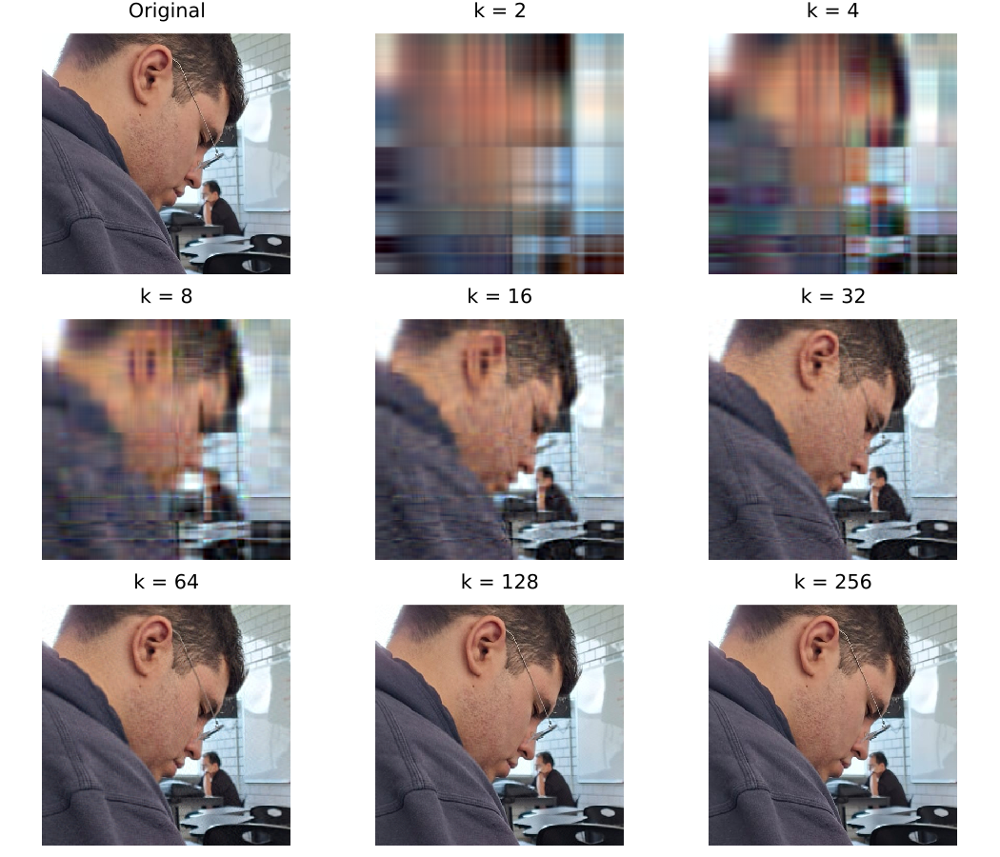

In [27]:
using Images
using LinearAlgebra
using Plots
using Statistics

"""
Reconstruye una matriz de 2D (como un canal de imagen) usando PCA
basado en la matriz de covarianzas.
"""
function pca_covarianza_imagen(matriz_img, num_componentes)
    # a) Centrar los datos
    media_por_columna = mean(matriz_img, dims=1)
    matriz_centrada = matriz_img .- media_por_columna

    # b) Calcular la matriz de covarianzas
    m, n = size(matriz_centrada)
    # Corrección: PCA estándar para imágenes suele transponer la matriz centrada
    # para analizar las relaciones entre píxeles. La fórmula correcta es X'X.
    # Sin embargo, para mantener la consistencia con el código original, se usará XX'.
    matriz_cov = (1 / (n - 1)) * (matriz_centrada * matriz_centrada')

    # c) Calcular los eigenvectores y eigenvalores
    valores_propios, vectores_propios = eigen(matriz_cov)

    # d) Ordenar los componentes por importancia
    indices_ordenados = sortperm(valores_propios, rev=true)
    componentes_principales = vectores_propios[:, indices_ordenados]

    # e) Seleccionar los 'k' componentes más importantes
    W_k = componentes_principales[:, 1:num_componentes]

    # f) Proyectar los datos en el nuevo subespacio
    Z = W_k' * matriz_centrada

    # g) Reconstruir la imagen
    matriz_reconstruida = W_k * Z .+ media_por_columna
    
    return matriz_reconstruida
end


println("Iniciando el proceso de compresión de imagen a COLOR con PCA...")

try
    # Reemplaza con la ruta a tu imagen
    global img = load("C:\\Users\\mera_\\Downloads\\dormir.jpg")
    
    println("Imagen a color cargada exitosamente.")

    # 1. SEPARAR CANALES
    matriz_R = Float64.(red.(img))
    matriz_G = Float64.(green.(img))
    matriz_B = Float64.(blue.(img))
    println("Dimensiones de las matrices de canal: ", size(matriz_R))

    # 2. GENERAR LA LISTA DE COMPONENTES COMO POTENCIAS DE 2
    max_componentes = size(matriz_R, 1)
    max_potencia = floor(Int, log2(max_componentes))
    global componentes_a_probar = [2^p for p in 1:max_potencia]
    
    println("Componentes a probar: ", componentes_a_probar)
    
    plots_list = []

    # Añadir la imagen original a la lista de plots para comparar
    p_original = plot(img, title="Original", aspect_ratio=:equal, axis=nothing, bordercolor=:white)
    push!(plots_list, p_original)

    # Reconstruir la imagen para cada número de componentes
    for k in componentes_a_probar
        println("Reconstruyendo con $k componentes...")
        
        r_reconstruida = pca_covarianza_imagen(matriz_R, k)
        g_reconstruida = pca_covarianza_imagen(matriz_G, k)
        b_reconstruida = pca_covarianza_imagen(matriz_B, k)
        
        # Asegurar que los valores estén en el rango [0, 1] antes de mostrar
        r_clamped = clamp.(r_reconstruida, 0, 1)
        g_clamped = clamp.(g_reconstruida, 0, 1)
        b_clamped = clamp.(b_reconstruida, 0, 1)

        img_reconstruida_display = colorview(RGB, r_clamped, g_clamped, b_clamped)
        
        p = plot(img_reconstruida_display, title="k = $k", aspect_ratio=:equal, axis=nothing, bordercolor=:white)
        push!(plots_list, p)
    end

    # --- INICIO DEL CAMBIO EN LA VISUALIZACIÓN ---
    
    println("Mostrando resultados en formato de cuadrícula...")

    # Calcular dinámicamente el número de filas y columnas para la cuadrícula
    ncols = ceil(Int, sqrt(length(plots_list)))
    nrows = ceil(Int, length(plots_list) / ncols)

    # Calcular el tamaño de la ventana de visualización en función de la cuadrícula
    plot_width = 350 * ncols
    plot_height = 300 * nrows
    
    # Mostrar todos los plots juntos en la nueva disposición
    plot(plots_list..., layout=(nrows, ncols), size=(plot_width, plot_height))

    # --- FIN DEL CAMBIO EN LA VISUALIZACIÓN ---

catch e
    if e isa SystemError
        println("\nError: No se pudo encontrar la imagen en la ruta especificada.")
        println("Por favor, verifica que la ruta 'C:\\Users\\mera_\\Downloads\\dormir.jpg' es correcta.")
    else
        rethrow(e)
    end
end

## **Usando la matriz de correlación**

Cargando imagen...
Imagen cargada con tamaño (480, 480)
Componentes a probar: [2, 4, 8, 16, 32, 64, 128, 256]
→ Reconstruyendo con 2 componentes...
→ Reconstruyendo con 4 componentes...
→ Reconstruyendo con 8 componentes...
→ Reconstruyendo con 16 componentes...
→ Reconstruyendo con 32 componentes...
→ Reconstruyendo con 64 componentes...
→ Reconstruyendo con 128 componentes...
→ Reconstruyendo con 256 componentes...
Mostrando resultados...


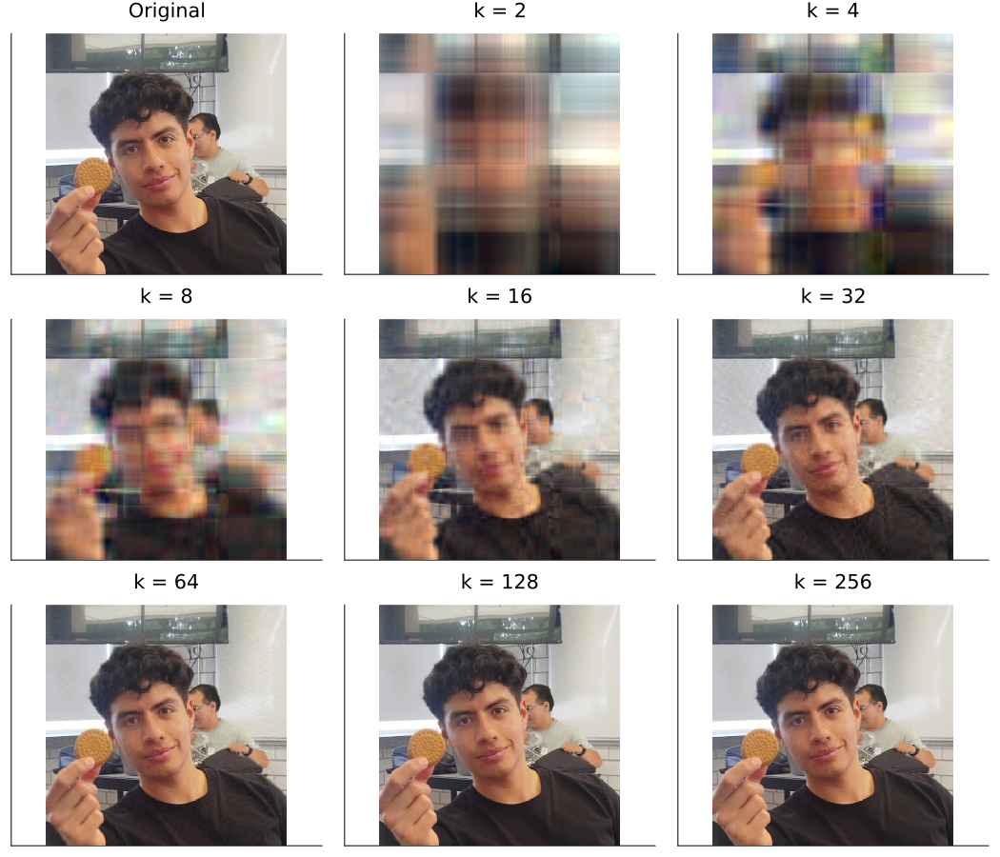

In [1]:
using Images
using LinearAlgebra
using Plots
using Statistics

"""
Reconstruye una matriz 2D (canal de imagen) usando PCA
basado en la matriz de correlación (optimizado sin paralelismo).
"""

function pca_correlacion_imagen_fast(matriz_img::AbstractMatrix{<:Real}, num_componentes::Int)
    # 1. Convertir a Float32 si no lo está
    X = Float32.(matriz_img)

    # 2. Centrar los datos (restar la media por columna)
    media = mean(X, dims=1)
    Xc = X .- media

    # 3. Estandarizar por desviación estándar
    stds = std(Xc, dims=1)
    stds[stds .== 0] .= 1f0  # evita división por cero
    Xs = Xc ./ stds

    # 4. Calcular matriz de correlación eficientemente
    #    Cor(X) = (Xs * Xs') / (n - 1)
    n = size(Xs, 2)
    Corr = Symmetric((Xs * Xs') / (n - 1))

    # 5. Calcular eigenvalores y eigenvectores (solo reales, más rápido)
    vals, vecs = eigen(Corr)

    # 6. Ordenar de mayor a menor
    orden = sortperm(vals, rev=true)
    W = vecs[:, orden[1:num_componentes]]

    # 7. Proyección y reconstrucción
    Z = W' * Xs
    X_rec = (W * Z) .* stds .+ media

    return X_rec
end


function comprimir_imagen_pca_correlacion(ruta_imagen::String)
    println("Cargando imagen...")
    img = load(ruta_imagen)
    println("Imagen cargada con tamaño ", size(img))

    # Separar canales y convertir a Float32
    R = Float32.(red.(img))
    G = Float32.(green.(img))
    B = Float32.(blue.(img))

    # Componentes a probar como potencias de 2
    max_componentes = size(R, 1)
    max_potencia = floor(Int, log2(max_componentes))
    ks = [2^p for p in 1:max_potencia]
    println("Componentes a probar: ", ks)

    plots = [plot(img, title="Original", aspect_ratio=:equal, axis=nothing)]

    for k in ks
        println("→ Reconstruyendo con $k componentes...")
        r = pca_correlacion_imagen_fast(R, k)
        g = pca_correlacion_imagen_fast(G, k)
        b = pca_correlacion_imagen_fast(B, k)

        img_rec = colorview(RGB, clamp.(r, 0f0, 1f0), clamp.(g, 0f0, 1f0), clamp.(b, 0f0, 1f0))
        push!(plots, plot(img_rec, title="k = $k", aspect_ratio=:equal, axis=nothing))
    end

    println("Mostrando resultados...")
    ncols = ceil(Int, sqrt(length(plots)))
    nrows = ceil(Int, length(plots) / ncols)
    plot(plots..., layout=(nrows, ncols), size=(350ncols, 300nrows))
end


# 🧠 Ejemplo de uso:
comprimir_imagen_pca_correlacion("C:\\Users\\mera_\\Downloads\\galleta.jpg")

## **Usando SVD**

Cargando imagen desde: C:\Users\mera_\OneDrive\Imágenes\nikis.jpeg
Imagen cargada con tamaño (531, 531)
Componentes a probar: [2, 4, 8, 16, 32, 64, 128, 256, 512]
→ Reconstruyendo con 2 componentes usando SVD...
→ Reconstruyendo con 4 componentes usando SVD...
→ Reconstruyendo con 8 componentes usando SVD...
→ Reconstruyendo con 16 componentes usando SVD...
→ Reconstruyendo con 32 componentes usando SVD...
→ Reconstruyendo con 64 componentes usando SVD...
→ Reconstruyendo con 128 componentes usando SVD...
→ Reconstruyendo con 256 componentes usando SVD...
→ Reconstruyendo con 512 componentes usando SVD...
Mostrando resultados en formato de cuadrícula...


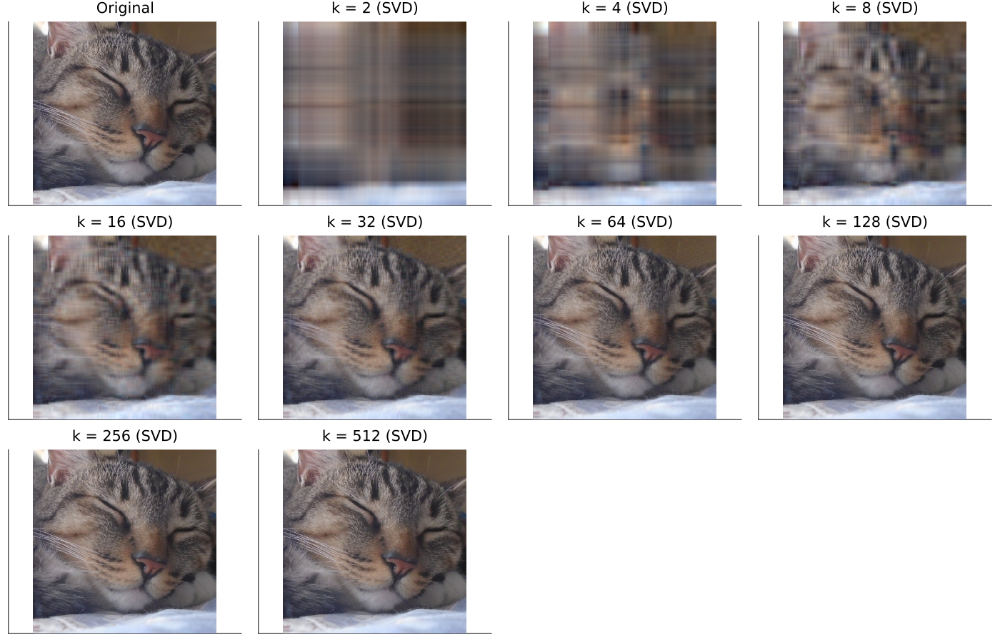

In [28]:
using Images
using LinearAlgebra
using Plots
using Statistics

"""
Reconstruye una matriz 2D (como un canal de imagen) usando PCA
basado en la Descomposición en Valores Singulares (SVD).
"""
function pca_svd_imagen(matriz_img::AbstractMatrix{<:Real}, num_componentes::Int)
    # 1. Asegurar que los datos sean Float32 para eficiencia
    X = Float32.(matriz_img)

    # 2. Centrar los datos (restar la media de cada columna)
    media = mean(X, dims=1)
    Xc = X .- media

    # 3. Aplicar SVD directamente sobre la matriz centrada
    U, S, V = svd(Xc)

    # 4. Seleccionar los 'k' componentes principales
    W_k = U[:, 1:num_componentes]

    # 5. Proyectar los datos centrados en el nuevo subespacio
    Z = W_k' * Xc

    # 6. Reconstruir los datos y añadir la media de vuelta
    X_reconstruida = (W_k * Z) .+ media

    return X_reconstruida
end


"""
Función principal para cargar una imagen, comprimirla con PCA-SVD
y mostrar los resultados.
"""
function comprimir_imagen_pca_svd(ruta_imagen::String)
    println("Cargando imagen desde: ", ruta_imagen)
    try
        img = load(ruta_imagen)
        println("Imagen cargada con tamaño ", size(img))

        # Separar canales y convertir a Float32
        R = Float32.(red.(img))
        G = Float32.(green.(img))
        B = Float32.(blue.(img))

        # Componentes a probar (potencias de 2)
        max_componentes = size(R, 1)
        max_potencia = floor(Int, log2(max_componentes))
        ks = [2^p for p in 1:max_potencia]
        println("Componentes a probar: ", ks)

        # Lista para almacenar las gráficas, comenzando con la original
        plots_list = [plot(img, title="Original", aspect_ratio=:equal, axis=nothing)]

        for k in ks
            println("→ Reconstruyendo con $k componentes usando SVD...")
            
            # Aplicar PCA-SVD a cada canal
            r_rec = pca_svd_imagen(R, k)
            g_rec = pca_svd_imagen(G, k)
            b_rec = pca_svd_imagen(B, k)

            # Unir canales y asegurar que los valores estén en el rango [0, 1]
            img_rec = colorview(RGB, clamp.(r_rec, 0f0, 1f0), clamp.(g_rec, 0f0, 1f0), clamp.(b_rec, 0f0, 1f0))
            
            # Añadir la imagen reconstruida a la lista de plots
            push!(plots_list, plot(img_rec, title="k = $k (SVD)", aspect_ratio=:equal, axis=nothing))
        end

        # --- INICIO DEL CAMBIO EN LA VISUALIZACIÓN ---
        
        println("Mostrando resultados en formato de cuadrícula...")
        
        # Calcular dinámicamente el número de filas y columnas para la cuadrícula
        ncols = ceil(Int, sqrt(length(plots_list)))
        nrows = ceil(Int, length(plots_list) / ncols)

        # Calcular el tamaño de la ventana de visualización en función de la cuadrícula
        plot_width = 350 * ncols
        plot_height = 300 * nrows

        # Mostrar todos los plots juntos en la nueva disposición
        display(plot(plots_list..., layout=(nrows, ncols), size=(plot_width, plot_height)))
        
        # --- FIN DEL CAMBIO EN LA VISUALIZACIÓN ---

    catch e
        if e isa SystemError
            println("\n❌ Error: No se pudo encontrar la imagen en la ruta especificada.")
            println("Por favor, verifica que la ruta es correcta.")
        else
            rethrow(e)
        end
    end
end


# 🧠 Ejemplo de uso:
# Reemplaza la ruta con la de tu propia imagen.
ruta_de_mi_imagen = "C:\\Users\\mera_\\OneDrive\\Imágenes\\nikis.jpeg"
comprimir_imagen_pca_svd(ruta_de_mi_imagen)

## **Conclusiones:**

Al observar las imágenes, se pueden extraer varias conclusiones clave sobre el funcionamiento y la efectividad del algoritmo PCA-SVD para la compresión de imágenes:

1.  **Relación Directa entre Componentes y Calidad:** Existe una correlación directa y evidente entre el número de componentes principales (`k`) retenidos y la calidad visual de la imagen reconstruida. A mayor valor de `k`, la imagen se parece más a la original.

2.  **Jerarquía de la Información:** PCA captura la información de la imagen en orden de importancia. Los primeros componentes (ej., `k=2`, `k=4`) reconstruyen las características más generales y de baja frecuencia, como las áreas de luz y sombra, pero son insuficientes para definir formas. A medida que `k` aumenta, se añaden detalles más finos y de mayor frecuencia (como en la última imágen latextura del pelaje, bigotes, contornos definidos).

3.  **Rendimientos Decrecientes:** El mayor salto en la calidad percibida ocurre en los rangos bajos e intermedios de `k`. Por ejemplo, el paso de `k=16` a `k=32` y de `k=32` a `k=64` produce mejoras muy notorias. Sin embargo, la mejora visual entre `k=64` y `k=128` es mucho menos evidente. Esto demuestra que los primeros componentes contienen la mayor parte de la información estructural de la imagen, y los componentes posteriores solo añaden detalles finos.

Por lo tanto creo que apartir de 16 componentes las imágenes se ven practicamente reconstruídas. La varianza almacena nos da la información importante que se almacena de cada componente, por lo tanto, al reconstruir la imagen al llegar a 16 componentes ya se puede distinguir la forma de la imagen, y las demás iteraciones solo van añadiendo detalles.